# Branin Experiment

In [1]:
# Imports
ENABLE_PJRT_COMPATIBILITY = 1

from typing import Callable

import equinox as eqx
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import numpy as np
import optax
from IPython.display import HTML
from jax import random
from jaxtyping import Array, Integer, PRNGKeyArray, PyTree, Real
from matplotlib.animation import FuncAnimation
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from matplotlib.patches import Ellipse, Polygon
from optax import GradientTransformation

In [2]:
# Constants

# Branin
A = 1
B = 5.1 / (4 * jnp.pi**2)
C = 5 / jnp.pi
R = 6
S = 10
T = 1 / (8 * jnp.pi)

# Plotting
MIN_X_1 = -6
MAX_X_1 = 12
MIN_X_2 = -2
MAX_X_2 = 18

# Elliptical region
ELLIPSE_CENTRE = jnp.array([-0.2, 7.5])
ELLIPSE_SEMI_AXES = jnp.array([3.6, 8.0])
ELLIPSE_ANGLE_DEG = 25
ELLIPSE_ANGLE_RAD = jnp.deg2rad(ELLIPSE_ANGLE_DEG)

# Training
NUM_SAMPLES = 6_000

# Diffusion
BETA_MIN = jnp.array(0.0001)
BETA_MAX = jnp.array(0.02)
T = jnp.array(1000)

Platform 'METAL' is experimental and not all JAX functionality may be correctly supported!


Metal device set to: Apple M2 Pro

systemMemory: 32.00 GB
maxCacheSize: 10.67 GB



W0000 00:00:1722357081.537549  942468 mps_client.cc:510] WARNING: JAX Apple GPU support is experimental and not all JAX functionality is correctly supported!
I0000 00:00:1722357081.545603  942468 service.cc:145] XLA service 0x14fffff00 initialized for platform METAL (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1722357081.545618  942468 service.cc:153]   StreamExecutor device (0): Metal, <undefined>
I0000 00:00:1722357081.546866  942468 mps_client.cc:406] Using Simple allocator.
I0000 00:00:1722357081.546879  942468 mps_client.cc:384] XLA backend will use up to 22906109952 bytes on device 0 for SimpleAllocator.


In [3]:
# Config
key = random.PRNGKey(100)

Consider the Branin function:
$$
f(x_1, x_2) = a(x_2 - bx_1^2 + cx_1 - r)^2 + s(1-t)\cos(x_1) + s
$$
where $a=1$, $b = \frac{5.1}{4\pi^2}$, $c=\frac{5}{\pi}$, $r=6$, $s=10$, $t=\frac{1}{8\pi}$.
It has three global minimas located at:

- $(-\pi, 12.275)$
- $(\pi, 2.275)$
- $(9.42478, 2.475)$

with a value of $0.397887$. We plot it below over the range $(x_1, x_2) \in [-6, 12] \times [-2, 18]$:

In [4]:
# Define Branin function
def get_branin(
    a: float = A, b: float = B, c: float = C, r: float = R, s: float = S, t: float = T
) -> Callable[[Real[Array, "..."], Real[Array, "..."]], Real[Array, "..."]]:
    def branin(x_1: Real[Array, "..."], x_2: Real[Array, "..."]) -> Real[Array, "..."]:
        return a * (x_2 - b * x_1**2 + c * x_1 - r) ** 2 + s * (1 - t) * jnp.cos(x_1) + s

    return branin


branin = get_branin()

minima_points = jnp.array([(-jnp.pi, 12.275), (jnp.pi, 2.275), (9.42478, 2.475)])

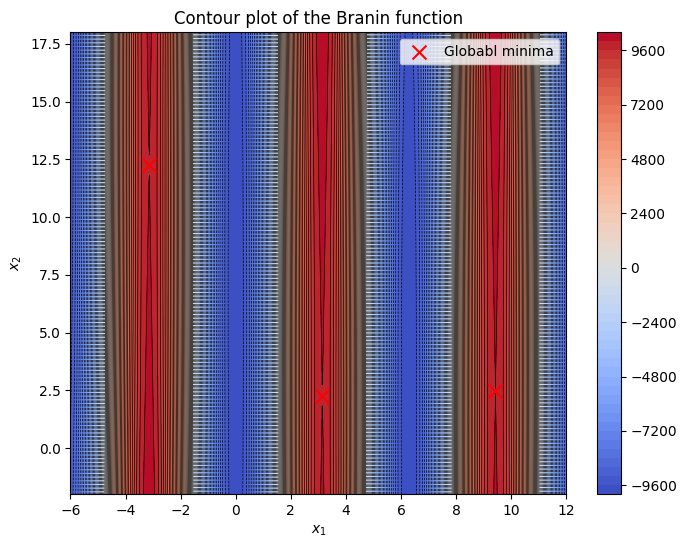

In [5]:
# Branin contour plot

# Create a grid of points
x_1_points = jnp.linspace(-6, 12, 1000)
x_2_points = jnp.linspace(-2, 18, 1000)
x_1_meshpoints, x_2_meshpoints = jnp.meshgrid(x_1_points, x_2_points)

# Evaluate the Branin function at each grid point
branin_values = branin(x_1_meshpoints, x_2_meshpoints)


def plot_branin_contour(
    x_1_meshpoints: Real[Array, "x_1 x_2"],
    x_2_meshpoints: Real[Array, "x_1 x_2"],
    branin_values: Real[Array, "x_1 x_2"],
    minima_points: Real[Array, "num_minima 2"],
) -> tuple[Figure, Axes]:
    fig, ax = plt.subplots(figsize=(8, 6))

    cp = ax.contourf(x_1_meshpoints, x_2_meshpoints, branin_values, levels=50, cmap="coolwarm")
    fig.colorbar(cp, ax=ax)

    ax.contour(
        x_1_meshpoints, x_2_meshpoints, branin_values, levels=50, colors="black", linewidths=0.5
    )

    ax.scatter(
        minima_points[:, 0],
        minima_points[:, 1],
        color="red",
        zorder=5,
        marker="x",
        s=100,
        label="Globabl minima",
    )

    ax.set_title("Contour plot of the Branin function")
    ax.set_xlabel("$x_1$")
    ax.set_ylabel("$x_2$")
    ax.set_xlim(MIN_X_1, MAX_X_1)
    ax.set_ylim(MIN_X_2, MAX_X_2)
    ax.legend()

    return fig, ax


# Use the function to plot
branin_fig, branin_ax = plot_branin_contour(
    x_1_meshpoints, x_2_meshpoints, branin_values, minima_points
)
plt.show()

Now consider some uniform prior sampling distribution over an ellipse region centered at
$(-0.2, 7.5)$ with semi-axis lengths $(3.6, 8)$, tilted $25\degree$. This region covers two of
the global minima:

- $(-\pi, 12.275)$
- $(\pi, 2.275)$

We plot this region atop the previous plot to demonstrate:

In [6]:
# Define ellipse
def get_ellipse() -> Ellipse:
    return Ellipse(
        xy=ELLIPSE_CENTRE,
        width=2 * ELLIPSE_SEMI_AXES[0],
        height=2 * ELLIPSE_SEMI_AXES[1],
        angle=ELLIPSE_ANGLE_DEG,
        edgecolor="orange",
        facecolor="none",
        linewidth=2,
        zorder=6,
        label="Prior sampling region",
    )

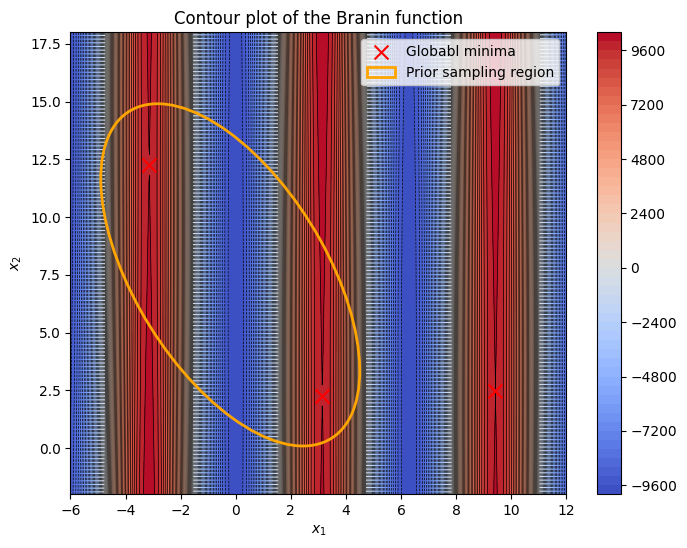

In [7]:
# Plot the points to visualize
branin_fig, branin_ax = plot_branin_contour(
    x_1_meshpoints, x_2_meshpoints, branin_values, minima_points
)
branin_ax.add_patch(get_ellipse())
branin_ax.legend()
plt.show()

Next, consider applying the following constraints:

\begin{align*}
x_2 &\leq \frac{3}{2}x_1 + \frac{15}{2} \\
x_2 &\leq -\frac{3}{2}x_1 + 15
\end{align*}

This further narrows down the feasible solution to just $(\pi, 2.275)$; we plot the region to
demonstrate:

In [8]:
# Find the intersection points of the constraints with the plot boundaries
def get_constraint_polygon() -> Polygon:
    # Intersection points to define the polygon
    x_min_1 = (MIN_X_2 - 15 / 2) / (3 / 2)
    x_max_1 = (MAX_X_2 - 15 / 2) / (3 / 2)
    x_min_2 = (MIN_X_2 - 15) / (-3 / 2)
    x_max_2 = (MAX_X_2 - 15) / (-3 / 2)

    # Intersection points to define the polygon
    polygon_points = [
        (x_min_1, MIN_X_2),
        (x_max_1, MAX_X_2),
        (x_max_2, MAX_X_2),
        (x_min_2, MIN_X_2),
    ]

    return Polygon(
        polygon_points,
        closed=True,
        edgecolor="pink",
        facecolor="pink",
        alpha=0.8,
        label="Feasible region",
        zorder=4,
    )

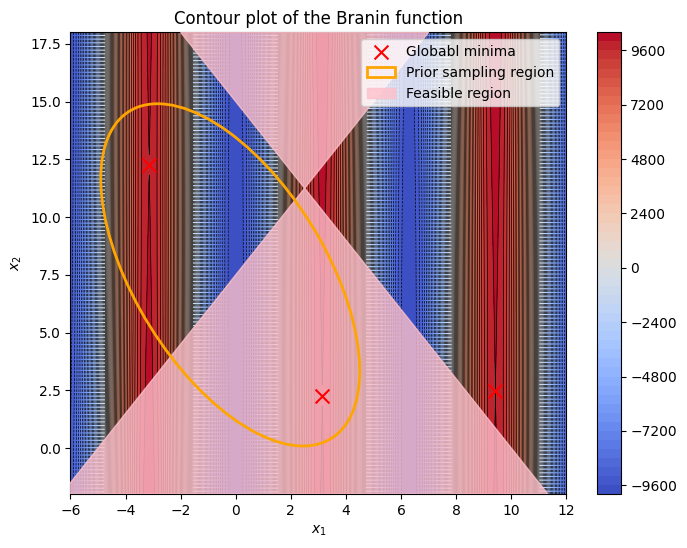

In [9]:
# Plot with constraint
branin_fig, branin_ax = plot_branin_contour(
    x_1_meshpoints, x_2_meshpoints, branin_values, minima_points
)
branin_ax.add_patch(get_ellipse())
branin_ax.add_patch(get_constraint_polygon())

branin_ax.legend()
plt.show()

Note here this seems to visually differ from the diagram in the Kong et al. (2024) paper,
suggesting a typo in their appendix where they define the constraints. Either way, functionally
it's fine since it still reduces the feasible minima to the same single value.

Now, we train a diffusion model to sample from the prior (i.e. uniformly within the ellipse).
While sampling from this distribution is obviously straightforward, we train a diffusion model
because we can then apply guidance according to the constraints (i.e. the Branin function and the
imposed feasible region), or rather their induced Boltzman distributions.

We use 6000 data points for training; we defer tuning and validation.

In [10]:
# Generate data points
def sample_unit_circle_uniform(n: int, key: PRNGKeyArray) -> Real[Array, "..."]:
    sub_key_1, sub_key_2 = random.split(key)

    angles = random.uniform(sub_key_1, (n,), minval=0, maxval=2 * jnp.pi)
    radii = jnp.sqrt(random.uniform(sub_key_2, (n,)))
    x = radii * jnp.cos(angles)
    y = radii * jnp.sin(angles)
    return jnp.vstack((x, y)).T


def unit_circle_to_ellipse(
    unit_circle_points: Real[Array, "batch 2"],
    semi_axes: Real[Array, "2"] = ELLIPSE_SEMI_AXES,
    angle_rad: Real[Array, ""] = ELLIPSE_ANGLE_RAD,
    center: Real[Array, "2"] = ELLIPSE_CENTRE,
) -> Real[Array, "batch 2"]:
    # Scale points to the ellipse dimensions
    ellipse_points = unit_circle_points * semi_axes

    # Rotation matrix for the given angle
    rotation_matrix = jnp.array(
        [[jnp.cos(angle_rad), -jnp.sin(angle_rad)], [jnp.sin(angle_rad), jnp.cos(angle_rad)]]
    )

    # Rotate the points
    rotated_points = ellipse_points.dot(rotation_matrix.T)

    # Translate the points to the specified center
    return rotated_points + center


key, sub_key = random.split(key)
unit_circle_points = sample_unit_circle_uniform(NUM_SAMPLES, sub_key)
ellipse_points = unit_circle_to_ellipse(unit_circle_points)

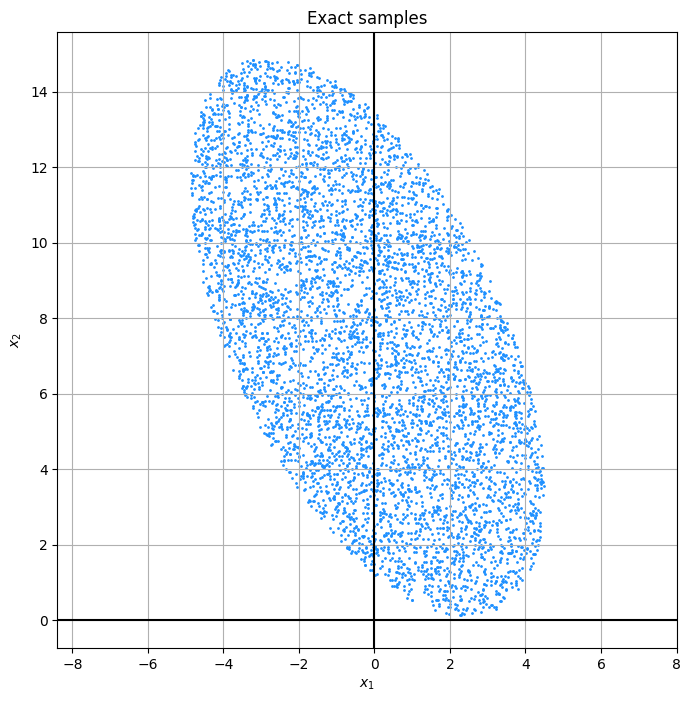

In [11]:
# Create scatter plot
fig, ax = plt.subplots(figsize=(8, 8))
ax.scatter(ellipse_points[:, 0], ellipse_points[:, 1], s=1, color="dodgerblue")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")

ax.grid(True)
ax.axhline(0, color="black")
ax.axvline(0, color="black")
ax.axis("equal")

plt.title("Exact samples")
plt.show()

Following Kong et al. (2024), we consider the variance preserving (VP) SDE:
$$
d\mathbf{x}_T = -\frac{1}{2}\beta(t)\mathbf{x}_t\,dt + \sqrt{\beta(t)}\,d\mathbf{w}_t,\quad \mathbf{x}_0 \sim p_0 = p_{data}
$$
In the discrete setting, we write the forward process as a Markov chain:
$$
q(\mathbf{x}_{1:T} \mid \mathbf{x}_0) = \prod_{t=1}^T q(\mathbf{x}_i \mid \mathbf{x}_{t-1})
$$
where
$$
\mathbf{X}_t \mid \mathbf{X}_{t-1} \sim \mathcal{N}(a_t\mathbf{x}_{t-1}, b_t^2 I_{d_x})
$$
Given the Gaussian transition, we can write:
$$
\mathbf{X}_t \mid \mathbf{X}_{0} \sim \mathcal{N}(c_t\mathbf{x}_0, d_t^2 I_{d_x})
$$
For the VP SDE:

\begin{align*}
a_t &= \sqrt{\alpha_t} \\
b_t &= \sqrt{\beta_t} \\
c_t &= \sqrt{\overline{\alpha}_t} \\
d_t &= \sqrt{1 - \overline{\alpha}_t}
\end{align*}

where

\begin{align*}
\alpha_t &:= 1 - \beta_t \\
\overline{\alpha}_t &:= \prod_{\tau=1}^t \alpha_\tau
\end{align*}

The backwards process can be similarly represented as a Markov chain with transition kernel
$p(x_{t-1} \mid x_t)$, where:
$$
X_{t-1} \mid X_t \sim \mathcal{N}(u_t\hat{\mathbf{x}}_0(x_t, t) + v_t\mathbf{s}_\theta(\mathbf{x}_t, t), w_t^2 I_{d_x})
$$
where
$$
\hat{\mathbf{x}}_0(x_t, t) := \frac{1}{c_t}\left(\mathbf{x}_t + d_t^2\mathbf{s}_\theta(\mathbf{x}_t, t)\right)
$$
is the (look-ahead) prediction of $\mathbf{x}_0$ given $\mathbf{x}_t$ (derived from Tweedie's
formula), and $\mathbf{s}_\theta$ is a neural network we train to estimate the score function
$\nabla_{\mathbf{x}_t}\log q(\mathbf{x}_t \mid \mathbf{x}_0)$.

For DDPM sampling:

\begin{align*}
u_t &= \sqrt{\alpha_{t-1}} \\
v_t &= -\sqrt{\alpha_t}(1 - \overline{\alpha}_{t-1}) \\
w_t &= \sqrt{\beta_t \cdot \frac{1 - \overline{\alpha}_{t-1}}{1 - \overline{\alpha}_t}}
\end{align*}


We'll use a linear noising schedule:
$$
\beta_t = \beta_{\text{min}} + t(\beta_{\text{max}} - \beta_{\text{min}})
$$
We'll consider $t \in \{0, \ldots, 1000\}$, and can examine the action of the forward noising
process:

In [12]:
# Define the diffusion
def beta_t(
    t: Real[Array, " batch"],
    beta_min: Real[Array, ""] = BETA_MIN,
    beta_max: Real[Array, ""] = BETA_MAX,
) -> Real[Array, " batch"]:
    return beta_min + t * (beta_max - beta_min) / T


def alpha_t(t: Real[Array, " batch"]) -> Real[Array, " batch"]:
    return 1 - beta_t(t)


alpha = alpha_t(jnp.arange(T + 1))
cumulative_alpha_values = jnp.cumprod(alpha)


def a_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(alpha_t(t))


def b_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(beta_t(t))


def c_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(cumulative_alpha_values[t])


def d_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(1 - cumulative_alpha_values[t])


def u_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(alpha_t(t - 1))


def v_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return -jnp.sqrt(alpha_t(t)) * (1 - cumulative_alpha_values[t - 1])


def w_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(
        beta_t(t) * (1 - cumulative_alpha_values[t - 1]) / (1 - cumulative_alpha_values[t])
    )


def forward_marginal(
    key: PRNGKeyArray, x_0: Real[Array, "batch dim"], t: Integer[Array, " batch"]
) -> Real[Array, "batch dim"]:
    m = c_t(t)
    v = d_t(t)
    noise = random.normal(key, x_0.shape)
    return m * x_0 + jnp.sqrt(v) * noise

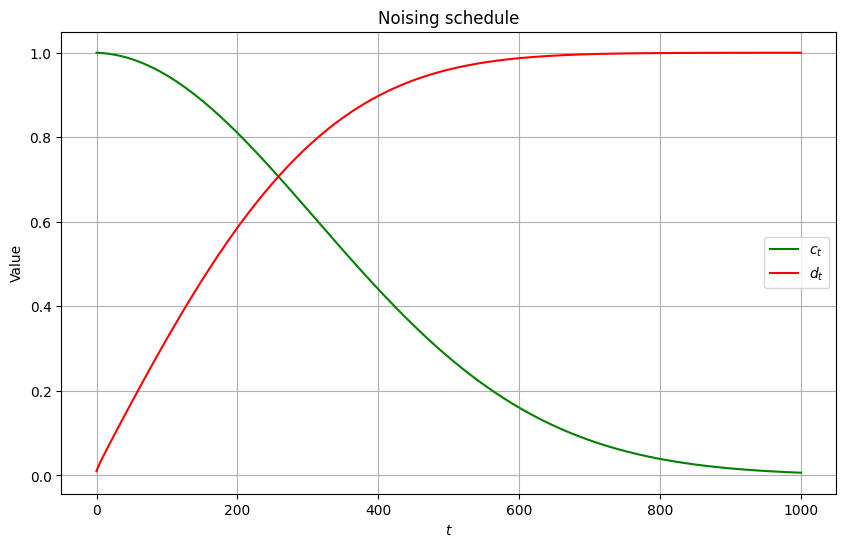

In [13]:
# Plot noising schedule
times = jnp.arange(T + 1)
c_values = c_t(times)
d_values = d_t(times)

plt.figure(figsize=(10, 6))

plt.plot(times, c_values, label="$c_t$", color="green")
plt.plot(times, d_values, label="$d_t$", color="red")

plt.xlabel("$t$")
plt.ylabel("Value")
plt.title("Noising schedule")
plt.legend()
plt.grid(True)
plt.show()

In [14]:
# Animation for forward noising
fig, ax = plt.subplots(figsize=(8, 8))
scat = ax.scatter(ellipse_points[:, 0], ellipse_points[:, 1], s=1, color="dodgerblue")

times = jnp.arange(0, T + 5, 5)
key, *sub_keys = random.split(key, len(times) + 1)
key_map = {int(t): sub_keys[i] for i, t in enumerate(times)}


def init():
    ax.grid(True)
    ax.set_xlim(-8, 8)
    ax.set_ylim(-4, 16)
    ax.set_xlabel("$x_1$")
    ax.set_ylabel("$x_2$")
    ax.axhline(0, color="black")
    ax.axvline(0, color="black")

    return (scat,)


def update(t):
    transformed_points = forward_marginal(key_map[int(t)], ellipse_points, t)
    scat.set_offsets(transformed_points)
    ax.set_title(f"Time: {t}")
    return (scat,)


ani = FuncAnimation(fig, update, frames=times, init_func=init, blit=True, interval=50)

plt.title("Forward noising")
plt.close()
HTML(ani.to_jshtml())

Next let's define and train our neural network for predicting the noise/score. We use the simple
architecture described [here](https://jakiw.com/diffusion_model_intro). We use the denoising
objective of Ho et al. (2020) rather than score-matching.

In [15]:
# Define network, loss, and training loop

class FullyConnectedWithTime(eqx.Module):
    """A simple model with multiple fully connected layers and some fourier features for the time
    variable.
    """

    layers: list[eqx.nn.Linear]

    def __init__(self, in_size: int, key: PRNGKeyArray):
        key1, key2, key3, key4 = jax.random.split(key, 4)
        out_size = in_size

        self.layers = [
            eqx.nn.Linear(in_size + 4, 256, key=key1),
            eqx.nn.Linear(256, 256, key=key2),
            eqx.nn.Linear(256, 256, key=key3),
            eqx.nn.Linear(256, out_size, key=key4),
        ]

    def __call__(self, x: Array, t: Array) -> Real[Array, "2"]:
        t_fourier = jnp.array(
            [t - 0.5, jnp.cos(2 * jnp.pi * t), jnp.sin(2 * jnp.pi * t), -jnp.cos(4 * jnp.pi * t)],
        ).squeeze(-1)

        x = jnp.concatenate([x, t_fourier])

        for layer in self.layers[:-1]:
            x = jax.nn.relu(layer(x))

        x = self.layers[-1](x)

        return x


@jax.jit
@jax.value_and_grad
def loss(
    model: FullyConnectedWithTime, data: Array, alpha_bar: Array, key: PRNGKeyArray
) -> Real[Array, ""]:
    key1, key2 = random.split(key, 2)

    random_times = random.randint(key1, (data.shape[0], 1), minval=0, maxval=T + 1)

    # NOTE: noise will match as both use key2
    noise = random.normal(key2, data.shape)
    noised_data = forward_marginal(key2, data, random_times)

    # NOTE: pass noise-to-signal ratio, alpha_bar, rather than times... not sure why
    # but probably to do with architecture being adapted from a score-matching architecture
    # where the time index ranged between 0 and 1... some rescaling thing?
    output = jax.vmap(model)(noised_data, alpha_bar[random_times])

    loss = jnp.mean((noise - output) ** 2)

    return loss


def fit(
    model: FullyConnectedWithTime,
    steps: int,
    optimizer: GradientTransformation,
    data: Array,
    alpha_bar: Array,
    rng: PRNGKeyArray,
    print_every: int = 5_000,
) -> FullyConnectedWithTime:
    opt_state = optimizer.init(eqx.filter(model, eqx.is_array))
    losses: list[float] = []

    @eqx.filter_jit
    def make_step(
        model: FullyConnectedWithTime,
        opt_state: PyTree,
        data: Array,
        alpha_bar: Array,
        step_rng: PRNGKeyArray,
    ):
        loss_value, grads = loss(model, data, alpha_bar, step_rng)
        updates, opt_state = optimizer.update(grads, opt_state, model)
        model = eqx.apply_updates(model, updates)

        return model, opt_state, loss_value

    for step in range(steps):
        step_rng, rng = random.split(rng, 2)
        model, opt_state, train_loss = make_step(
            model,
            opt_state,
            data,
            alpha_bar,
            step_rng,
        )
        losses.append(train_loss)

        if (step % print_every) == 0 or (step == steps - 1):
            mean_loss = jnp.mean(jnp.array(losses))
            print(f"{step=},\t avg_train_loss={mean_loss}")

    return model

In [16]:
# Training
# NOTE: some weird bug where crashes after too many epochs; probably some Metal thing though...

n_epochs = 30_000

key, sub_key = random.split(key)
denoiser_model = FullyConnectedWithTime(2, key=sub_key)
optimizer = optax.adamw(learning_rate=1e-3)

key, sub_key = random.split(key)
fitted_model = fit(
    denoiser_model, n_epochs, optimizer, ellipse_points, cumulative_alpha_values, sub_key
)

step=0,	 avg_train_loss=0.9873044490814209
step=5000,	 avg_train_loss=0.41354483366012573
step=10000,	 avg_train_loss=0.4118228852748871
step=15000,	 avg_train_loss=0.41116341948509216
step=20000,	 avg_train_loss=0.41077858209609985
step=25000,	 avg_train_loss=0.4105471670627594
step=29999,	 avg_train_loss=0.4103482663631439


Next we'll define an unconditional sampling function and demonstrate that the network is well
targeting the distribution.

In [17]:
# Define unguided sampling function
def unguided_sampling(
    key: PRNGKeyArray,
    n_samples: int,
    model: eqx.Module,
    alpha_bar: Array,
) -> tuple[Array, np.ndarray]:
    key, sub_key = random.split(key)
    all_outputs = np.zeros((T + 1, n_samples, 2))
    scores = np.zeros((T + 1, n_samples, 2))

    # Time T
    x_t = random.normal(sub_key, (n_samples, 2))
    all_outputs[T, :, :] = x_t

    for t in range(T, 0, -1):
        key, sub_key = random.split(key)

        alpha_bar_t = alpha_bar[t] * jnp.ones((x_t.shape[0], 1))

        noise_estimate = jax.vmap(model)(x_t, alpha_bar_t)
        score_estimate = -noise_estimate / w_t(t)

        # DDPM: Algorithm 2
        x_t: Array = ((x_t - (b_t(t) ** 2 / d_t(t)) * noise_estimate) / a_t(t)) + (
            b_t(t) * random.normal(sub_key, x_t.shape) if t != 0 else 0
        )

        all_outputs[t - 1, :, :] = x_t
        scores[t - 1, :, :] = score_estimate

    return x_t, all_outputs, scores

In [18]:
# Sampling (unguided)
n_samples = 1000
samples, all_outputs, scores = unguided_sampling(
    key, n_samples, fitted_model, cumulative_alpha_values
)

We can visualize now the (learned) reverse process:

In [19]:
# Animate reverse process
SHOW_SCORES = False

fig, ax = plt.subplots(figsize=(8, 8))
ax.grid(True)
ax.set_xlim(-8, 8)
ax.set_ylim(-4, 16)
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
ax.axhline(0, color="black")
ax.axvline(0, color="black")
ax.add_patch(get_ellipse())

# NOTE: initial point irrelevant for scatters but matters for quiver offsets...
scat = ax.scatter(all_outputs[0, :, 0], all_outputs[0, :, 1], c="dodgerblue", s=1)

if SHOW_SCORES:
    quiver = ax.quiver(
        all_outputs[0, :, 0],
        all_outputs[0, :, 1],
        scores[0, :, 0],
        scores[0, :, 1],
        color="red",
        alpha=0.5,
    )

def update(t):
    ax.set_title(f"Time: {t}")
    scat.set_offsets(all_outputs[t])

    if SHOW_SCORES:
        quiver.set_offsets(all_outputs[t])
        quiver.set_UVC(scores[t, :, 0], scores[t, :, 1])

    return scat, quiver if SHOW_SCORES else scat,


ani = FuncAnimation(fig, update, frames=jnp.arange(T, -5, -5), interval=50, blit=True)
plt.close()

HTML(ani.to_jshtml())

In [20]:
from diffusionlib.sampler import SamplerName, get_sampler
from diffusionlib.smc.feynman_kac_model import LikelihoodGuidedPF
from diffusionlib.smc.state_space_model import SimpleObservationSSM

In [21]:
from dataclasses import dataclass
from typing import Callable

import jax.numpy as jnp
from jax import lax, random, vmap
from jaxtyping import Array, PRNGKeyArray

from diffusionlib.sampler.base import Sampler
from diffusionlib.util.misc import (
    batch_mul,
    continuous_to_discrete,
    get_linear_beta_function,
    get_times,
    get_timestep,
)


@dataclass(kw_only=True)
class DDIMVP(Sampler):
    """DDIM Markov chain. For the DDPM Markov Chain or VP SDE."""

    # model: DDIM parameterizes the `epsilon(x, t) = -1. * fwd_marginal_std(t) * score(x, t)` function.
    # eta: the hyperparameter for DDIM, a value of `eta=0.0` is deterministic 'probability ODE' solver, `eta=1.0` is DDPMVP.
    num_steps: int = 1000
    shape: tuple[int, ...]
    model: Callable[[Array, Array], Array]
    beta_min: float
    beta_max: float
    eta: float
    denoise: bool = True
    stack_samples: bool = False
    inverse_scaler: Callable[[Array], Array] = lambda x: x

    def __post_init__(self):
        self.ts, self.dt = get_times(self.num_steps)
        self.beta, _ = get_linear_beta_function(beta_min=0.1, beta_max=20.0)
        self.discrete_betas = continuous_to_discrete(vmap(self.beta)(self.ts.flatten()), self.dt)
        self.alphas = 1.0 - self.discrete_betas
        self.alphas_cumprod = jnp.cumprod(self.alphas, axis=0)
        self.sqrt_alphas_cumprod = jnp.sqrt(self.alphas_cumprod)
        self.sqrt_1m_alphas_cumprod = jnp.sqrt(1.0 - self.alphas_cumprod)
        self.alphas_cumprod_prev = jnp.append(1.0, self.alphas_cumprod[:-1])
        self.sqrt_alphas_cumprod_prev = jnp.sqrt(self.alphas_cumprod_prev)
        self.sqrt_1m_alphas_cumprod_prev = jnp.sqrt(1.0 - self.alphas_cumprod_prev)

    def sample(self, rng: PRNGKeyArray, x_0: Array | None = None) -> Array:
        rng, step_rng = random.split(rng)

        if x_0 is None:
            x_0 = self.prior_sampling(step_rng, self.shape)
        else:
            assert x_0.shape == self.shape

        x = x_0
        (_, x, x_mean), xs = lax.scan(self._step, (rng, x, x), self.ts, reverse=True)

        return_samples = (
            self.inverse_scaler(xs)
            if self.stack_samples
            else self.inverse_scaler(x_mean if self.denoise else x)
        )

        return return_samples

    def prior_sampling(self, rng: Array, shape: tuple[int, ...]) -> Array:
        return random.normal(rng, shape)

    def _step(
        self, carry: tuple[PRNGKeyArray, Array, Array], outer_t: Array
    ) -> tuple[tuple[PRNGKeyArray, Array, Array], Array]:
        rng, x, x_mean = carry
        rng, step_rng = random.split(rng)

        vec_t = jnp.full((self.shape[0], 1), outer_t)
        x, x_mean = self._update(step_rng, x, vec_t)

        return ((rng, x, x_mean), x_mean) if self.denoise else ((rng, x, x_mean), x)

    def _update(self, rng: Array, x: Array, t: Array) -> tuple[Array, Array]:
        x_mean, std = self.posterior(x, t)
        z = random.normal(rng, x.shape)
        x = x_mean + batch_mul(std, z)

        return x, x_mean

    def posterior(self, x: Array, t: Array) -> tuple[Array, Array]:
        """Get parameters for $p(x_{t-1} \\mid x_t)$"""
        epsilon = self.model(x, t)
        timestep = get_timestep(t, self.ts[0], self.ts[-1], self.num_steps)
        m = self.sqrt_alphas_cumprod[timestep]
        sqrt_1m_alpha = self.sqrt_1m_alphas_cumprod[timestep]
        v = sqrt_1m_alpha**2
        alpha_cumprod = self.alphas_cumprod[timestep]
        alpha_cumprod_prev = self.alphas_cumprod_prev[timestep]
        m_prev = self.sqrt_alphas_cumprod_prev[timestep]
        v_prev = self.sqrt_1m_alphas_cumprod_prev[timestep] ** 2
        x_0 = batch_mul((x - batch_mul(sqrt_1m_alpha, epsilon)), 1.0 / m)
        coeff1 = self.eta * jnp.sqrt((v_prev / v) * (1 - alpha_cumprod / alpha_cumprod_prev))
        coeff2 = jnp.sqrt(v_prev - coeff1**2)
        x_mean = batch_mul(m_prev, x_0) + batch_mul(coeff2, epsilon)
        std = coeff1

        return x_mean, std


: 

In [22]:
beta_min = 0.01
beta_max = 20.0

key, sub_key = random.split(key)

sampler = DDIMVP(
    num_steps=T,
    shape=(1000, 2),
    model=jax.vmap(fitted_model),
    beta_min=beta_min,
    beta_max=beta_max,
    eta=1.0,  # NOTE: equates to using DDPM
    stack_samples=True,
)

prior_samples: Real[Array, "{num_steps} {num_samples} {dim_x}"] = sampler.sample(sub_key)